### EV353 Oceanography and Climate In-class Data Analysis Activity

**The global mixed layer depth and its seasonal variations**

The ocean MLD, *h* is a key variable in many fundamental equations and budgets in physical oceanography. For this activity, you will work with the IFREMER Mixed Layer Depth (MLD) Climatology. The dataset is a globally gridded climatology of MLD informed by hydrographic profiles taken from ships, floats, etc. The dataset has 2° spatial resolution and includes monthly averages from 1941-2002.

The dataset `mld.nc` has multiple criteria for defining the MLD, including one based on a temperature change relative to the surface (0.2°C) and one based on a density change relative to the surface (0.03 kg/m$^3$).  

- **mld_DT:** mixed layer depth using temperature criterion, DT=0.2 deg C; (units: m) (month x lat x lon)
- **mld_DR:** mixed layer depth using density criterion, DR=0.03 kg/m; (units: m) (month x lat x lon)

**Reference for the data:** deBoyer et al. (2004) "Mixed layer depth over the global ocean: An examination of profile data and a profile-based climatology," *Journal of Geophysical Research*

---

**1. Open and display the mixed layer depth dataset using xarray (sample code provided below for you to modify)**

```
# open dataset using xarray (mld.nc)
filePath = 'paste your filepath here'
ds = xr.open_dataset(filePath)

# display dataset
ds
```

**2. Then generate global maps of the average annual cycle of mixed layer depth using both MLD criteria (temperature and salinity)** 

**3. Once you generate your maps, interpret the results!**
- Compare and contrast the annual cycle of MLD at different locations around the world
- Investigate how the two MLD criteria compare at different locations 
- Discuss which processes are important for explaining the observed *spatial* patterns
- Discuss which processes are important for explaining the observed *temporal changes* throughout the course of a year

Add your observations and discussion notes in a Markdown cell.

In [1]:
# import Python packages
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cmocean
import cartopy.crs as ccrs
import cartopy.feature as cfeature

In [2]:
ds = xr.open_dataset('/Users/a_rust/Documents/EV353_Oceanography/mld.nc')
ds

mld_DR = ds['mld_DR']
mld_DT = ds['mld_DT']
ds

<xarray.Dataset>
Dimensions:  (time: 12, lat: 90, lon: 180)
Coordinates:
  * time     (time) uint8 1 2 3 4 5 6 7 8 9 10 11 12
  * lat      (lat) float32 -88.0 -86.0 -84.0 -82.0 -80.0 ... 84.0 86.0 88.0 89.5
  * lon      (lon) float32 0.0 2.0 4.0 6.0 8.0 ... 350.0 352.0 354.0 356.0 358.0
Data variables:
    mld_DR   (time, lat, lon) float32 ...
    mld_DT   (time, lat, lon) float32 ...
Attributes:
    description:  ocean mix layer depth

/var/folders/yy/crmtkkv97bgcmxfw41l38hv40000gr/T/ipykernel_2335/400458671.py:32: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(9, 4.5), dpi=300)


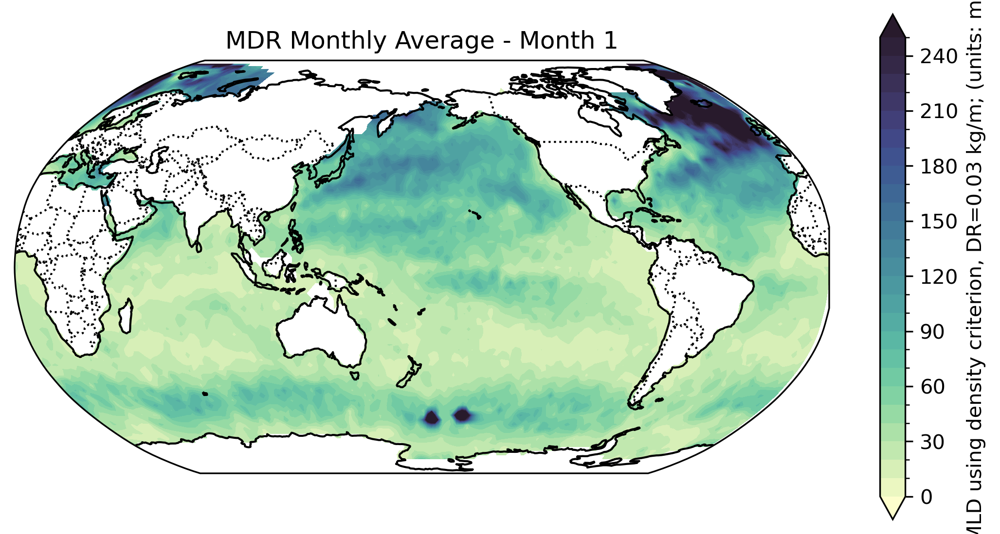

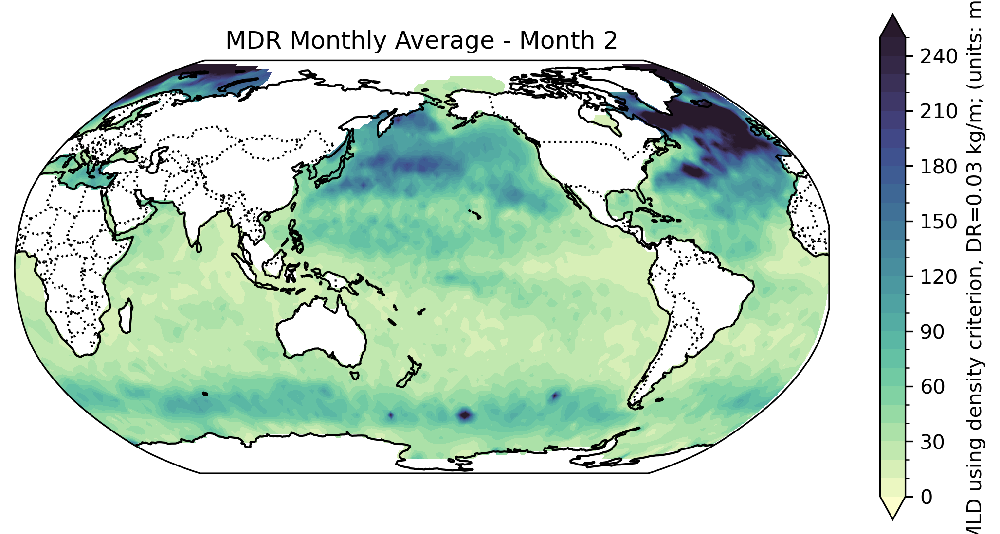

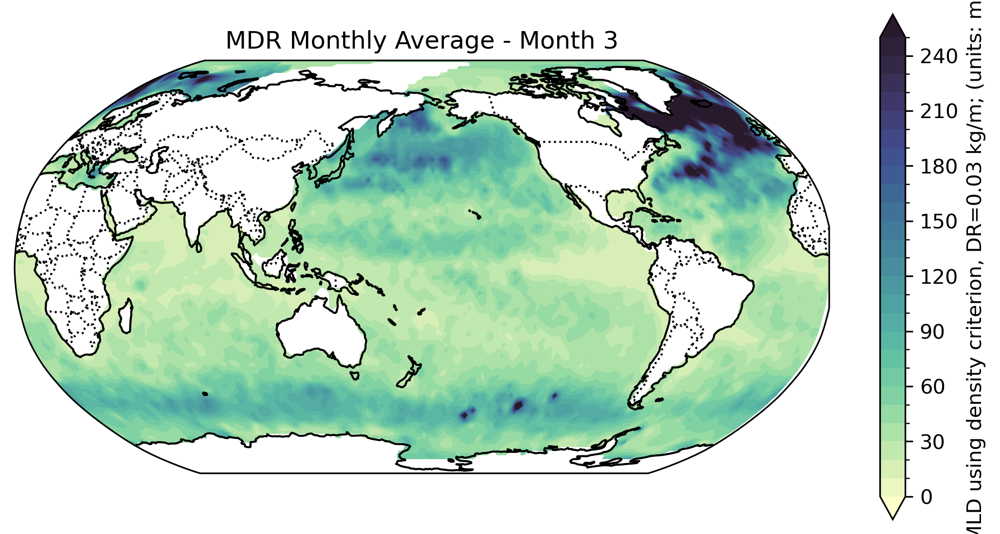

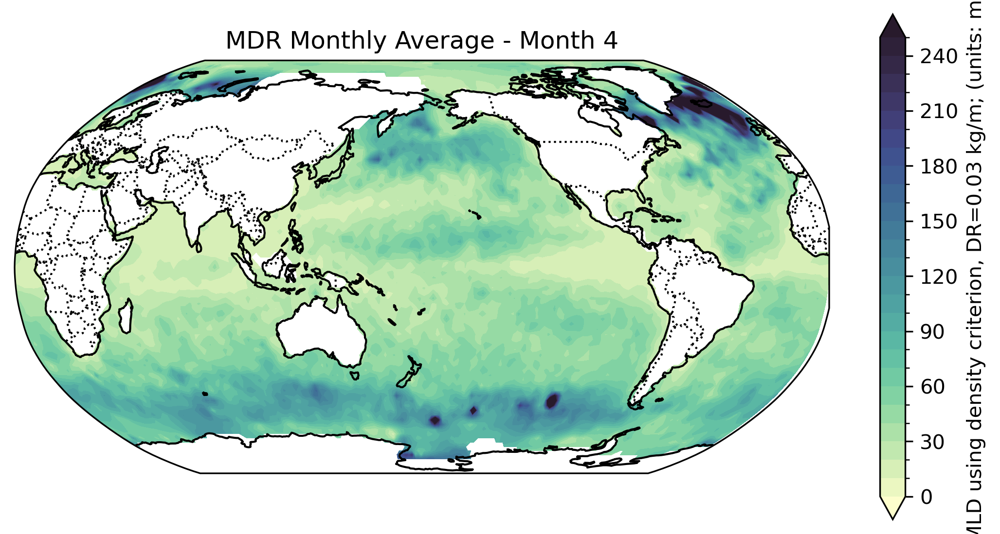

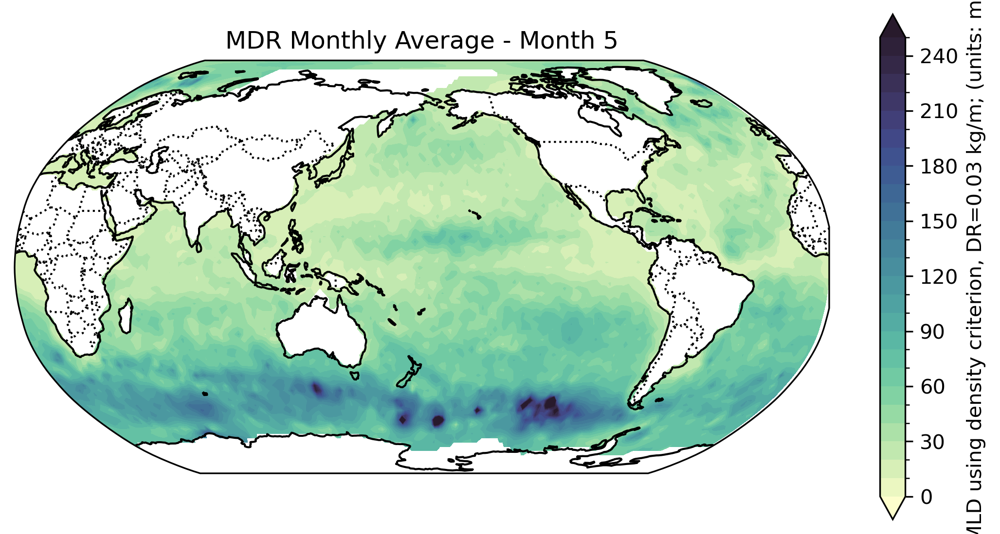

...

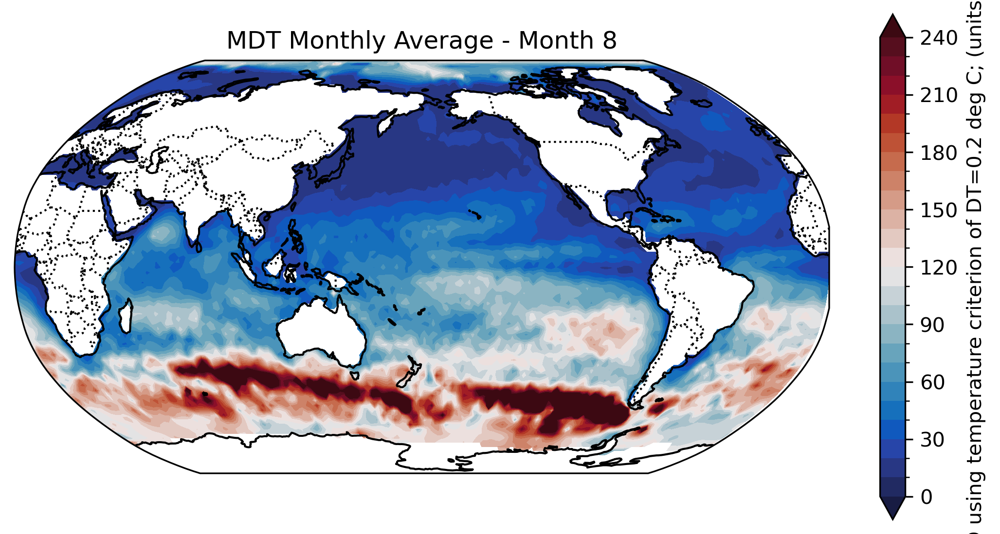

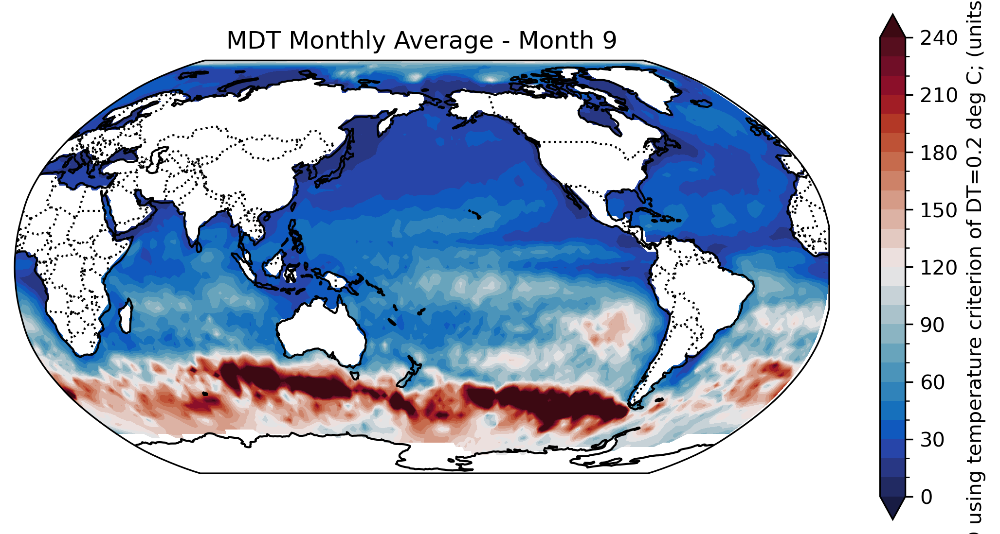

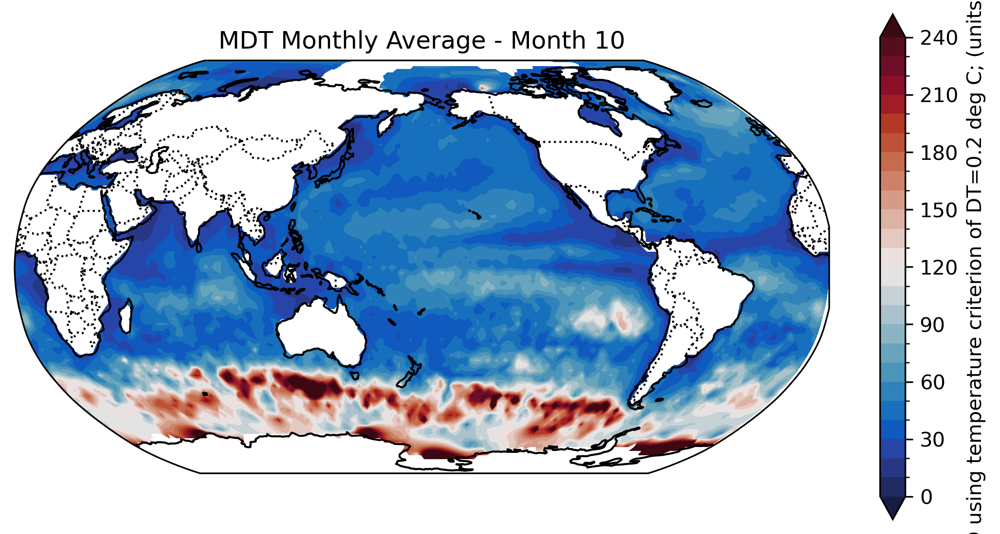

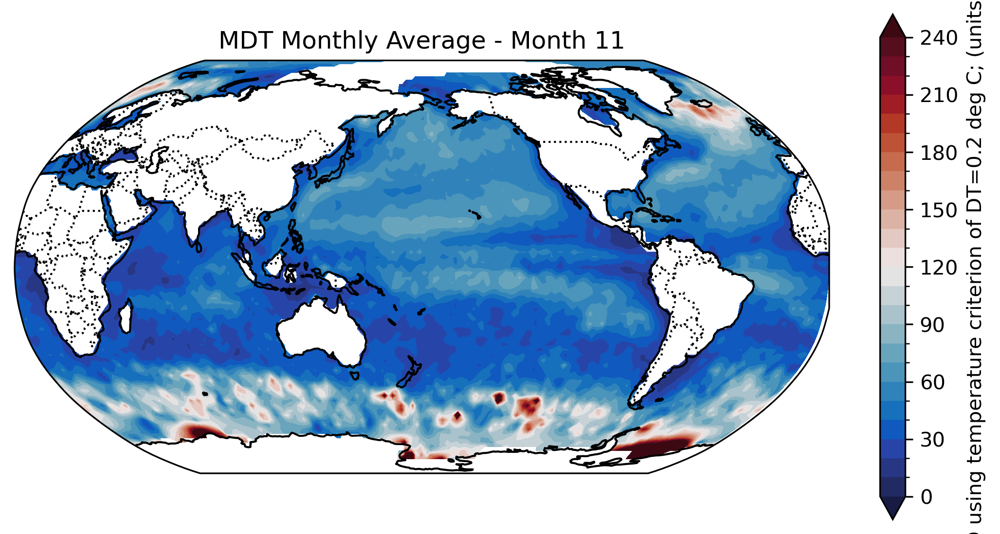

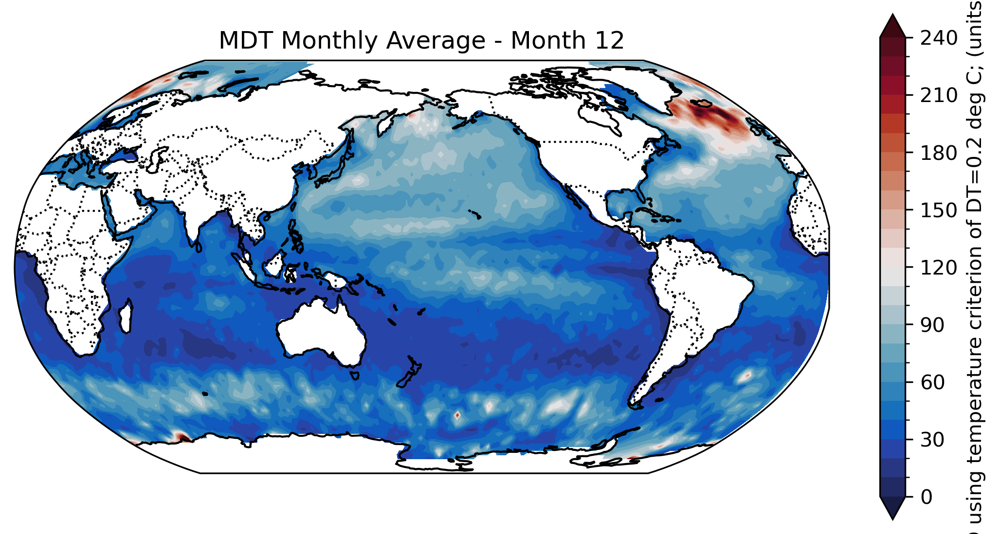

In [3]:
proj = ccrs.Robinson(central_longitude=180)
cmap = cmocean.cm.deep
lev = np.arange(0, 260, 10)

#DR
for i in range(12):
    fig = plt.figure(figsize=(9, 4.5), dpi=300)
    ax = plt.axes(projection=proj)

    mld_DR.isel(time=i).plot.contourf(
        x='lon',
        y='lat',
        ax=ax,
        transform=ccrs.PlateCarree(),
        levels=lev,
        cmap=cmap,
        extend='both',
        cbar_kwargs={'label': 'MLD using density criterion, DR=0.03 kg/m; (units: m)'}
    )

    ax.coastlines(resolution='110m')
    ax.add_feature(cfeature.BORDERS, linestyle=':')
    ax.set_title(f'MDR Monthly Average - Month {i + 1}')
    fig.savefig(f'mdr_monthly_avg_{i + 1}.png', bbox_inches='tight', facecolor='white')

proj = ccrs.Robinson(central_longitude=180)
cmap = cmocean.cm.balance
lev = np.arange(0, 250, 10)

#DT
for i in range(12):
    fig = plt.figure(figsize=(9, 4.5), dpi=300)
    ax = plt.axes(projection=proj)

    mld_DT.isel(time=i).plot.contourf(
        x='lon',
        y='lat',
        ax=ax,
        transform=ccrs.PlateCarree(),
        levels=lev,
        cmap=cmap,
        extend='both',
        cbar_kwargs={'label': 'MLD using temperature criterion of DT=0.2 deg C; (units: m)'}
    )

    ax.coastlines(resolution='110m')
    ax.add_feature(cfeature.BORDERS, linestyle=':')
    ax.set_title(f'MDT Monthly Average - Month {i + 1}')
    fig.savefig(f'mdt_monthly_avg_{i + 1}.png', bbox_inches='tight', facecolor='white')
   

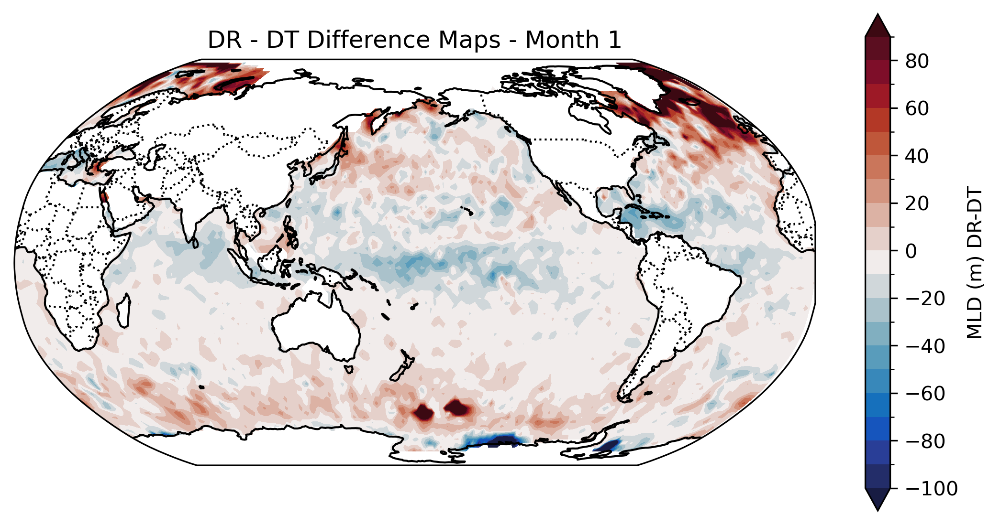

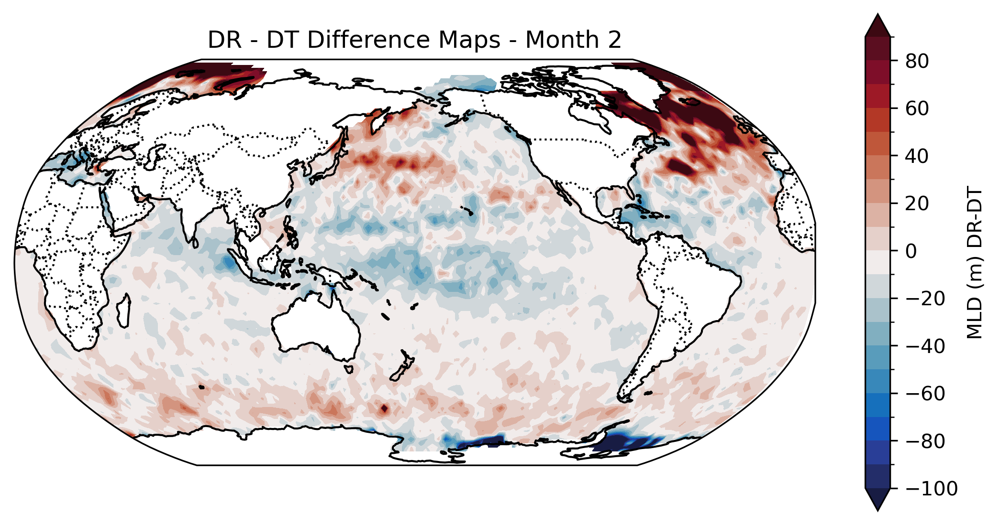

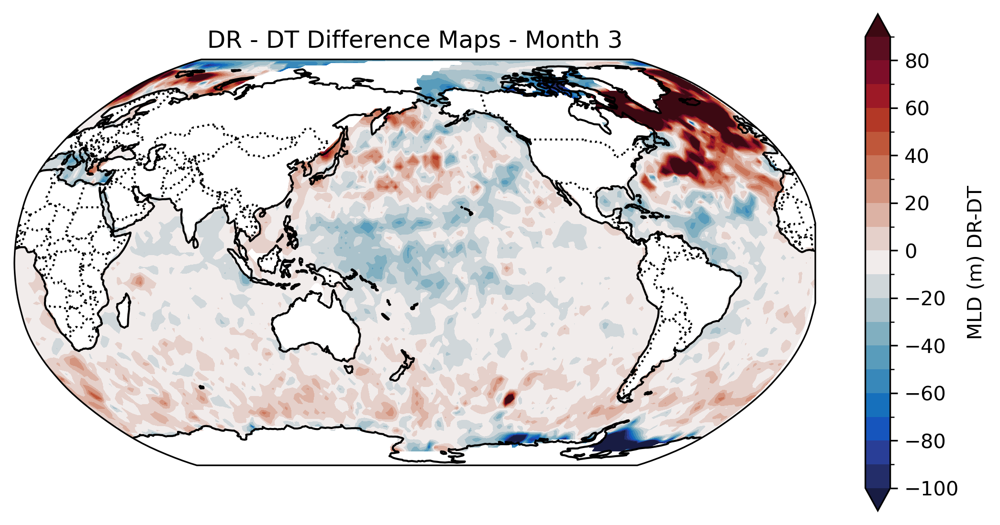

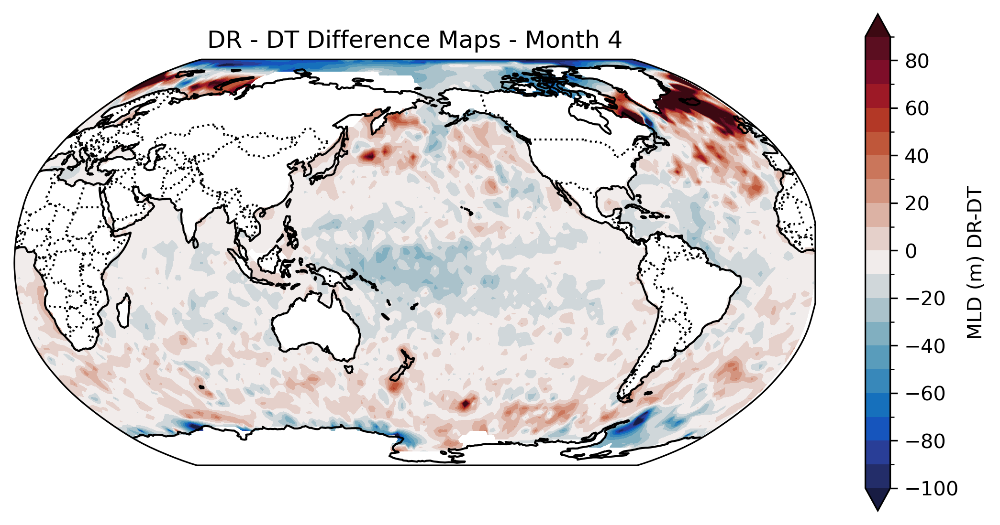

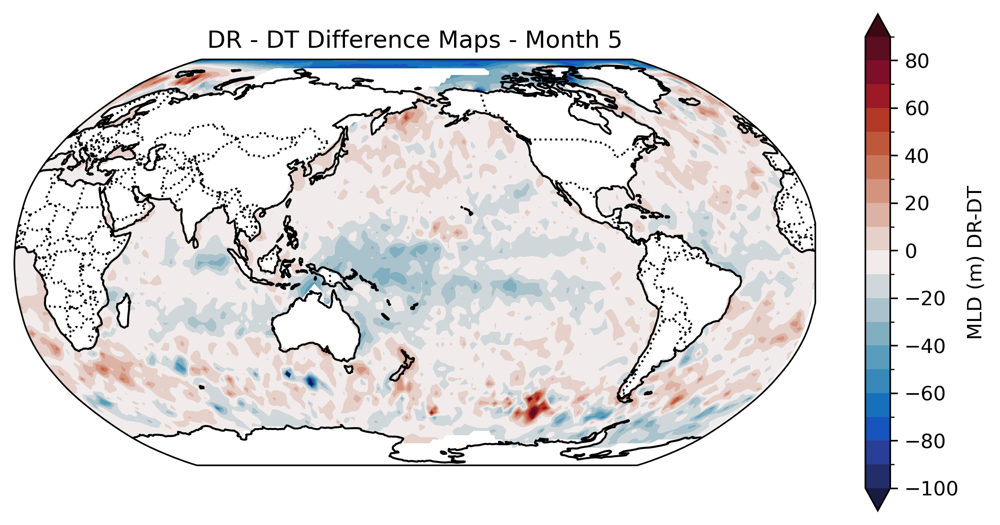

...

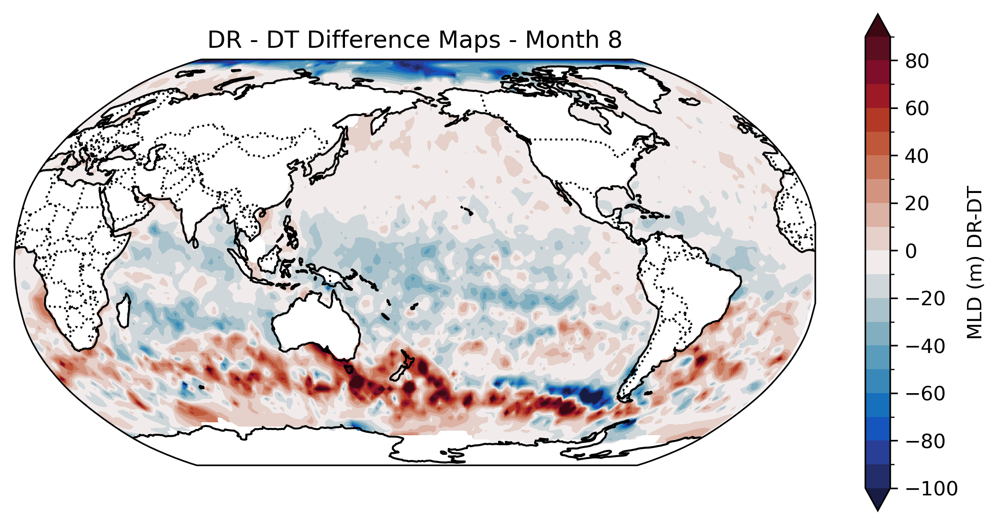

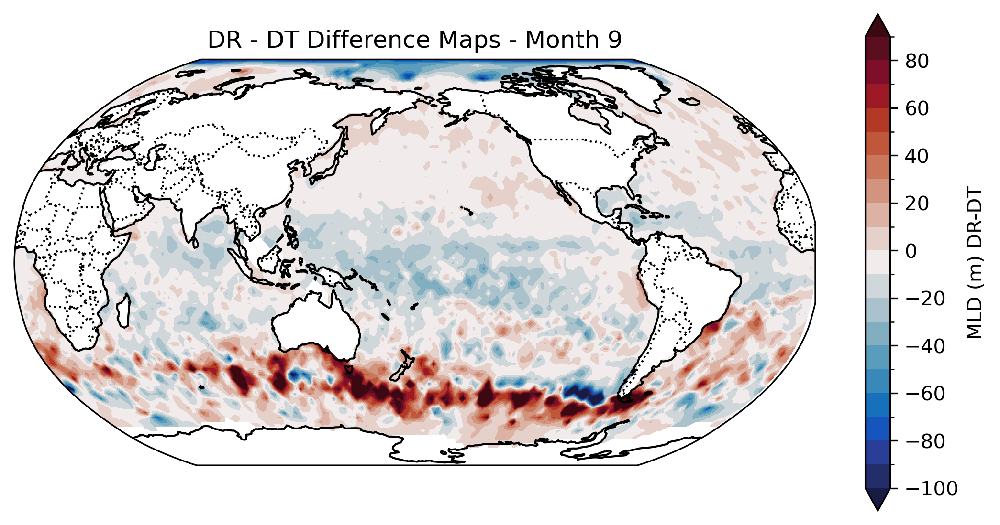

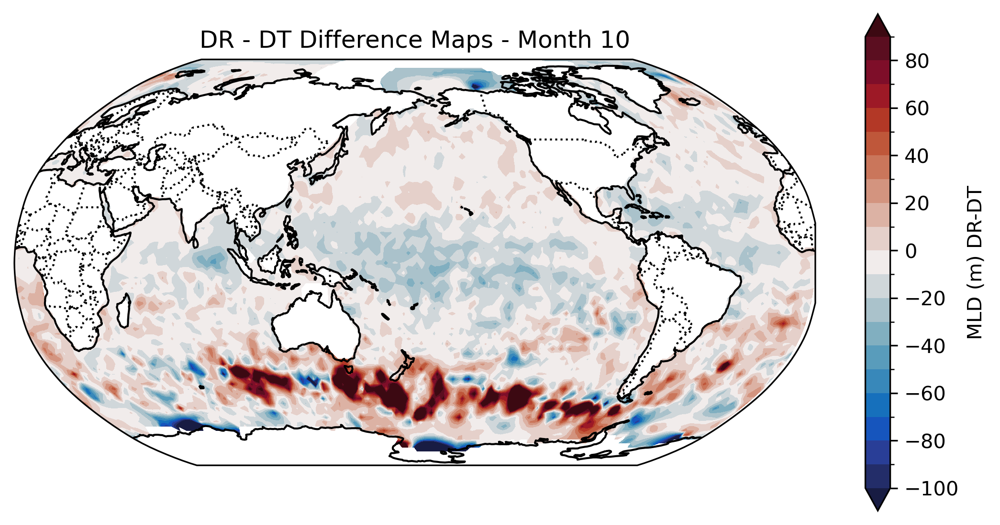

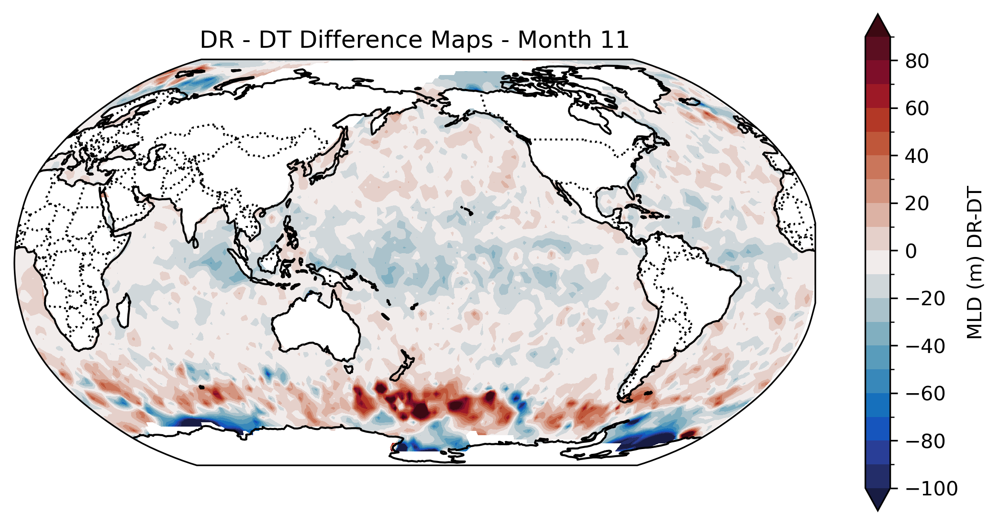

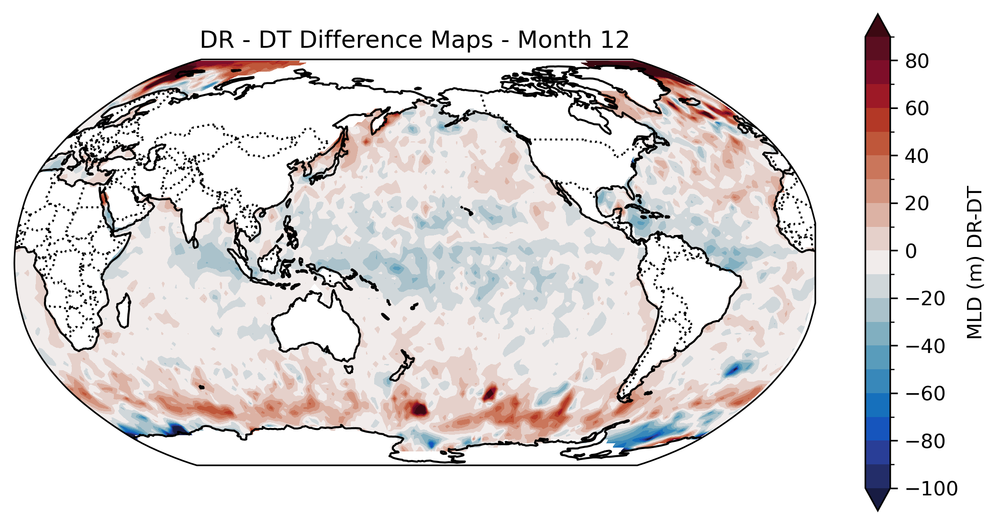

In [11]:
# Difference
diff = mld_DR - mld_DT

proj = ccrs.Robinson(central_longitude=180)
cmap = cmocean.cm.balance
lev = np.arange(-100, 100, 10)

#DR
for i in range(12):
    fig = plt.figure(figsize=(9, 4.5), dpi=300)
    ax = plt.axes(projection=proj)

    diff.isel(time=i).plot.contourf(
        x='lon',
        y='lat',
        ax=ax,
        transform=ccrs.PlateCarree(),
        levels=lev,
        cmap=cmap,
        extend='both',
        cbar_kwargs={'label': 'MLD (m) DR-DT'}
    )

    ax.coastlines(resolution='110m')
    ax.add_feature(cfeature.BORDERS, linestyle=':')
    ax.set_title(f'DR - DT Difference Maps - Month {i + 1}')
    fig.savefig(f'dr_dt_monthly_diff_{i + 1}.png', bbox_inches='tight', facecolor='white')

proj = ccrs.Robinson(central_longitude=180)
cmap = cmocean.cm.balance
lev = np.arange(0, 250, 10)


## Compare and contrast the annual cycle of MLD at different locations around the world
## Investigate how the two MLD criteria compare at different locations
The MLD variable changes very similarly for the DR and DT variables over the course of the year. The general trend I observe is a deeper ML in the N.Hemisphere during January-April with a maximum depth occuring during February in the North Atlantic, and then the MLD deepening in the S.Hemisphere during May-November peaking during September in the Southern Ocean. However, these two variables differ in their definition of the MLD over the course of the year. In January-April the difference figures show that a density defined MLD is deeper than a Temperature defined MLD in the North Pole. As the year goes on, this trend switches to the Southern Hemisphere. Remaining constant over the course of the year is the salinity defined MLD being deeper along the equator than the density definition.


## Discuss which processes are important for explaining the observed spatial patterns
Processes that are important for understaning the spatial patterns of MLD could be attributed to latitude and the precipitaion and evaporation associated with each. For instance, around the equator we see that the salinity defined MLD is deeper than the temperature defined one, and this could be due to high precipitation at this area causing overall lower salinity levels and thus a weaker salinity gradient between the ML and the ocean below. Additionally, in regards to the poles the proximity to sea-ice may play a role in the density and temperature of the ocean and thus impact the spatial patterns. As sea-ice melts that adds freshwater to the ocean and decreases density, which we see in boreal summer in by the N. Pole. One final explanation is due to winds. 


## Discuss which processes are important for explaining the observed temporal changes throughout the course of a year
The processes important in these changes in temporal observations could be attributed to the tilt of the Earth depending on the season. This would explain why the MLD increases in the Northern Hemisphere in the beginning of the year and why the Southern Hemisphere MLD increases towards the latter half of the year. Another explanation could be due to changes in evaporation and precipitation--having to do with seasons (ITCZ shifting, or seasonal monsoons). Temperature shifts of SST over the year could also be attributed to these changes in these variables--especially density which is temperature dependent. Finally, winds also change seasonally and as they strengthen (during the Winter) this deepends the ML. The winds are stronger during the winter because of the difference in temperature and pressure between the equator and the pole.

## Class Discussion Notes
-solar radiation
-sea ice formation
-EP balance
-Riverine output
-strength of vertical mixing (where there's upwelling, there is a much shallower ML)
-winds!! (stronger winds lead to deeper ML)